# Python Assignment 1
### MCT4001 - Kristian Wentzel

### 1. Importing libraries and a wavefile

The wavefile is an arrangement of 3 different grooves made with the PO-16 Pocket Operator.
I chose this as the soundsource because it consists of defined percussive and harmonic elements, and I like the sound of it.


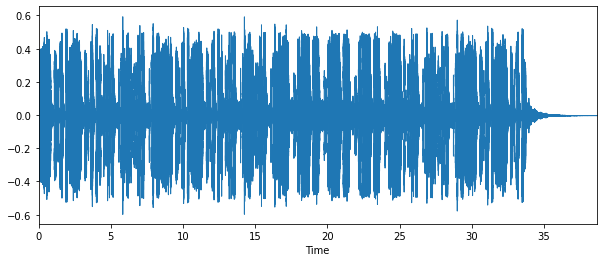

In [1]:
import librosa, librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd
import numpy as np
import soundfile as sf

# path/filename for my soundfile
file = './Files/3PO2.wav'

# loading the file. (22050Hz and Mono by default)
wav, sr = librosa.load(file)

# Setting the default values as variables, so I can easily change them all across
hop_length = 512
frame_length = 2048

plt.figure(figsize=(10, 4))
librosa.display.waveplot(wav)
ipd.Audio(wav, rate=sr)

### 2. Computing spectral features from the wavefile
Computing the spectral centroid and rms from the wavefile. In addition, I'll decompose the wavefile into harmonic and percussive components for more focused spectral extraction. This data will be mapped to pitch and amplitude in the re-synthesizing process.

In [2]:
# Computing the rms of the original file
rms = librosa.feature.rms(wav, hop_length=hop_length, frame_length=frame_length)

# Decompose harmonic and percussive components of the wavefile into new arrays
wav_harmonic, wav_percussive = librosa.effects.hpss(wav)

# computing spectral centroid from the percussive component and rms from the harmonic component
rms_perc = librosa.feature.rms(wav_percussive, hop_length=hop_length, frame_length=frame_length)
cent_harm = librosa.feature.spectral_centroid(wav_harmonic, hop_length=hop_length, n_fft=frame_length)

**Visualization**

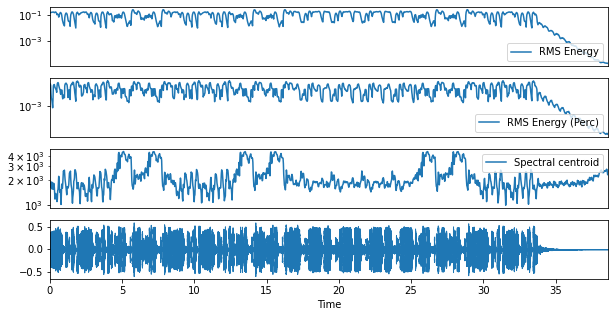

In [3]:
# visualization of the different components along with the wavefile for reference

plt.figure(figsize=(10, 5))
# First subplot: RMS
plt.subplot(4, 1, 1)
plt.semilogy(rms.T, label='RMS Energy')
plt.xticks([])
plt.xlim([0, rms.shape[-1]])
plt.legend(loc='lower right')
# First subplot: RMS of Percussive component
plt.subplot(4, 1, 2)
plt.semilogy(rms_perc.T, label='RMS Energy (Perc)')
plt.xticks([])
plt.xlim([0, rms_perc.shape[-1]])
plt.legend(loc='lower right')
# Third subplot: Spectral centroid of Harmonic component
plt.subplot(4, 1, 3)
plt.semilogy(cent_harm.T, label='Spectral centroid')
plt.xticks([])
plt.xlim([0, cent_harm.shape[-1]])
plt.legend(loc='lower right')
plt.legend()
# Fourth subplot: original waveform
plt.subplot(4, 1, 4)
librosa.display.waveplot(wav, sr=sr)
plt.show()

**Sound examples**

The *harmonic* content:

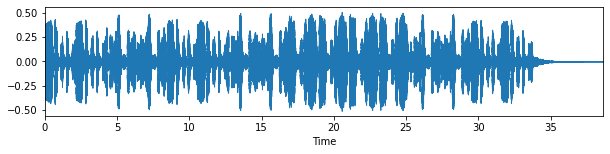

In [4]:
plt.figure(figsize=(10, 2))
librosa.display.waveplot(wav_harmonic)
ipd.Audio(wav_harmonic, rate=sr)

The *percussive* content:

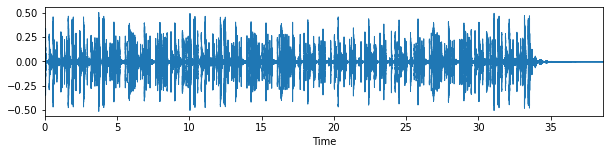

In [5]:
plt.figure(figsize=(10, 2))
librosa.display.waveplot(wav_percussive)
ipd.Audio(wav_percussive, rate=sr)

### 2.1 Computing an onset strength envelope from the percussive component
I'll extract the onset envelope of the percussive component mapped for use on an additional counter-melody later.

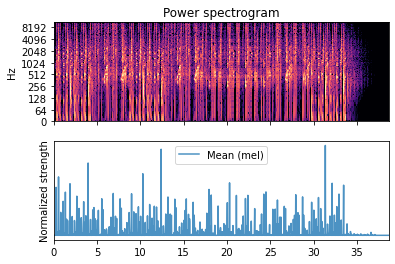

In [6]:
# Computing an onset strength envelope
onset_env = librosa.onset.onset_strength(y=wav_percussive, sr=sr, max_size=50)

D = np.abs(librosa.stft(wav_percussive))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

ax[1].plot(times, 2 + onset_env / onset_env.max(), alpha=0.8,
           label='Mean (mel)')
ax[1].legend()
ax[1].set(ylabel='Normalized strength', yticks=[])

# Flattening for iteration
onset_env_flat = onset_env.flatten()

### 3. Looking at some numbers
Finding the length of different components, and computing the length of frames in ms.

In [7]:
# The amount of samples in my wavefile
print("Number of samples in original:\t\t",wav.shape[0])

# The amount of samples per frame in the spectral features
print("Samples per frame in spectral features:\t",rms.shape[1])

# The length of the wavefile in seconds
wave_length = librosa.get_duration(wav)
print("Length of wavefile (s):\t\t\t {:.3f}".format(wave_length))

#The length of each frame in ms
frame_ms = wave_length/rms.shape[1]*1000
print("Length of frame (ms):\t\t\t {:.3f}".format(frame_ms))

# Checking if every feature has the same frame-length, and storing it as a variable
if rms.shape[1] == cent_harm.shape[1] == rms_perc.shape[1] == onset_env.shape[0]:
    frame_len = rms.shape[1]
print('\nOverall number of samples per frame:\t',frame_len)

Number of samples in original:		 851832
Samples per frame in spectral features:	 1664
Length of wavefile (s):			 38.632
Length of frame (ms):			 23.216

Overall number of samples per frame:	 1664


### 4.1 Size-checker

For later, I'll need a size-adjuster to check for and adjust possibly small differences in the amp envelope and sine_synth arrays, made by floating point calculation differences.

In [8]:
# Using a function to adjust the amp envelope to the same size as the generated sine
def sizeAdjust(amp, dur_ms):
    
    # Adjust length if different
    if amp.size != dur_ms.size:
        
        # Deleting if too big
        if amp.size > dur_ms.size:
            diff = amp.size-dur_ms.size            
            amp = np.delete(amp, diff)
            
        # Zero-padding if too small
        elif dur_ms.size > amp.size:
            padding = dur_ms.size - amp.size
            amp = np.pad(amp, padding)
            amp = amp[padding:amp.size]
            
    # Do nothing if they have the same size
    else:
        pass
    
    return amp

In [9]:
# Defining the sine_synth function

def sine_synth(freq, dur_ms, amp=1, pha=0, sr=sr):

    t = np.arange(0,dur_ms/1000,1/sr)

    # Adjusting the amp array to match 't', if needed
    amp = sizeAdjust(amp, t)
    
    s = amp*np.sin(2*np.pi*freq*t+pha)
   
    return s

### 4.2 Envelope generator (AHD) to smooth out edges

The attack and decay stages are each set to 20% of the total duration.

In [10]:
# An AHD-style envelope generator (Attack, Hold, Decay) where you can set the hold amplitude.
def envelope(dur_ms, amp=1, sr=sr):
    
    # Using the same timeframe(s) as the sine_synth
    t = np.arange(0, dur_ms/1000, 1/sr)
    
    # Separating the stages of the envelope with a long hold time,
    # and a shorter attack and decay times (20% each), which has same length as the overlap.
    attack_length = int(len(t) * 0.2)
    hold_length = int(len(t) * 0.6)
    decay_length = int(len(t) * 0.2)
    
    # Making ramps up to the desired amplitude and back down
    attack = np.linspace(0, amp, num=attack_length)
    hold = np.linspace(amp, amp, num=hold_length)
    decay = np.linspace(amp, 0, num=decay_length)
    
    # Assembling the curve
    env = np.concatenate((attack, hold, decay))
    
    return env

### 4.1 Adding a synth_harmony function for harmonizing purposes
I want to add layers of harmony the melody. Therefore, I'll define a new function (which is calling upon the sine_synth function) for harmonization purposes. This way, I won't have to repeat myself for each harmonic layer.

---

**Update**: This will also handle the overlapping of sine-chunks. 

A note on the numbers chosen:
I want to make the overlaps the same length as the attack and decay stages of the envelope. (20% of the end of a segment overlapping with 20% of the start of the next segment.) To do this, I'll make the segments 25% longer than they should be. In that way, overlapping 20% of each segment will in effect remove the extra length added and make the total length the same as if not overlapping. To make sure this is carried out correct, I'll treat the first and last sample differently. The first segment will of course not overlap with any previous sample, and the last segment will not be made 25% longer.

Consider the following example, with 5 segments of 100 samples:
```python
# 25% of 100
100 * 0.25 == 25
# 20% of 125
125 * 0.2 == 25


# Without overlapping:
100 + 100 + 100 + 100 + 100 == 500

# With overlapping:
#       ______ _______      ______ _______  
#      |      2       |    |      4       |
   100 + 25 + 75 + 25 + 75 + 25 + 75 + 25 + 75 == 500
#|____1____|    |______3_______|    |____5____|

# The 25 + 75 + 25 stages of the mid segments correspond to the attack/hold/decay stages of the envelope.
```

In [11]:
# Defining the "harmonizing" synth_harmony function
def synth_harmony(freq_source, amp_source, harmony=1, amplitude=1):

    """freq_source = The source component for mapping to pitch. (E.g 'cent_harm' for spectral centroid of harmonic component)
    amp_source = The source component for mapping to amplitude. (E.g 'rms' for RMS of the original wavefile)
    harmony [default '1'] = The relation of this layer to the fundamental for the purpose of making harmonies. (E.g '2' for an octave up)
    amplitude [default '1'] = Setting the volume of this particular voice. (E.g '0.8' for 80% volume (relative to amp_source output)"""

    # Initializing a synth-array
    this_voice = np.array(0)
    # A counter for itirating on the second parameter (amp)
    amp_frame = 0
    
    # Synthesizing a sequence of sines, mapped to parameters of the wave.
    for frekvens in freq_source[0]:
        
        # The first segment
        if amp_frame == 0:
            # Synthesizing the first sine-chunk with an amp envelope, making both 25% longer.
            temp_synth = sine_synth((frekvens/2)*harmony, frame_ms*1.25, amp=envelope(frame_ms*1.25, amp_source[0, amp_frame]*amplitude))
            this_voice = np.append(this_voice, temp_synth)

        # The last segment
        elif amp_frame == frame_len-1:
            # The last segment is not made longer
            temp_synth = sine_synth((frekvens/2)*harmony, frame_ms, amp=envelope(frame_ms, amp_source[0, amp_frame]*amplitude))
            
            # I'm overlapping without zero-padding, by summing the end (decay) of the previous segment
            # with the start (attack) of the new segment in an 'overlap' variable.
            overlap = this_voice[-int(len(temp_synth)*0.25):] + temp_synth[:int(len(temp_synth)*0.25)]
            
            # The end (decay) of the last segment is replaced with the overlap,
            # containing both the previous end (decay), and the new start (attack).
            this_voice[-int(len(temp_synth)*0.25):] = overlap
            
            # The start (attack) of the new segment is removed, before being added to the previous segments.
            this_voice = np.append(this_voice, temp_synth[int(len(temp_synth)*0.25):])
            
        # In-between segments
        else:
            # Made 25% longer
            temp_synth = sine_synth((frekvens/2)*harmony, frame_ms*1.25, amp=envelope(frame_ms*1.25, amp_source[0, amp_frame]*amplitude))
            
            # Overlapping, in the same fasion as with the last segment.
            overlap = this_voice[-int(len(temp_synth)*0.2):] + temp_synth[:int(len(temp_synth)*0.2)]
            this_voice[-int(len(temp_synth)*0.2):] = overlap
            this_voice = np.append(this_voice, temp_synth[int(len(temp_synth)*0.2):])
        
        # Updating the counter
        amp_frame += 1
        
    return this_voice

### 5. Synthesizing sound mapped to parameters of the waveform
This will be the 'fundamental' voice of the melody.

- The spectral centroid of the harmonic content is mapped to the frequency, and the rms of the original is mapped to the amplutide.
- I chose this to make the re-synthesized version resemble the "shape" of the original.
- I extracted the spectral centroid of the harmonic content to avoid noise/artifacts from the percussive elements.
- I thought of using the rms from the percussive content for the amplitude, but in my mind it sounded better with the overall rms.

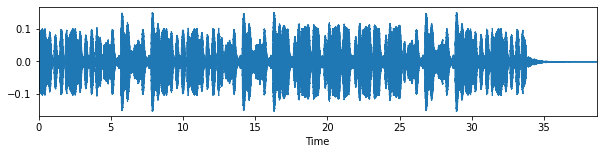

In [12]:
# Synthesizing the fundamental of the melody
# 'cent_harm' is mapped to frequency and 'rms' is mapped to amplitude
synthesized_fund = synth_harmony(cent_harm, rms, amplitude=0.6)

# Visualizing and auditing the synthesized voice:
plt.figure(figsize=(10, 2))
librosa.display.waveplot(synthesized_fund)
ipd.Audio(synthesized_fund,rate=sr)

### 5.1 Adding different harmonies to the synthesized melody
I'll make different adjustments to the frequency relations and the overall amplitude of the individual harmonies.

In [13]:
# Making a voice an octave up, with a slight change from rms to rms_perc controlling amp
synthesized_octave_up = synth_harmony(cent_harm, rms, harmony=2, amplitude=0.8)

# Making a voice an octave down
synthesized_octave_down = synth_harmony(cent_harm, rms, harmony=0.5, amplitude=0.4)

# Making a voice a fifth below
synthesized_fifth_above = synth_harmony(cent_harm, rms, harmony=3/2, amplitude=0.3)

    
# The different harmonies are now:
# synthesized_fund            The fundamental
# synthesized_octave_up       An octave up
# synthesized_octave_below    An octave below
# synthesized_fifth_above     The fifth above

### 5.2 Merging the synthesized harmonies into one harmonic voices

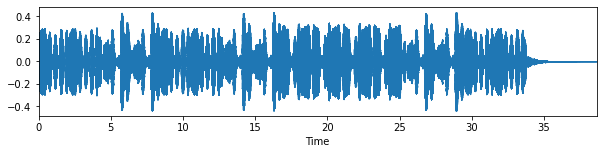

In [14]:
# Merging the voices into one
synthesized_harm = synthesized_fund + synthesized_octave_up + synthesized_octave_down + synthesized_fifth_above

# The visualizing and sound of the harmonic voice
plt.figure(figsize=(10, 2))
librosa.display.waveplot(synthesized_harm)
ipd.Audio(synthesized_harm,rate=sr)

### 5.3 Synthesizing a counter-melody
I wanted to make a completely different voice to supplement the harmonized melody.
- The frequency is mapped to the onset envelope of the percussive component and the amplitude is mapped to the central spectroid of the harmonic component.
- I tried this mapping to mix things up and was pleased with the result.
    - I had to work a lot with "scaling" of the new mapping for the frequency/amplitude to make it sound meaningful.
- The counter-melody is "filtered" by inserting silence (0 Hz sine) above and below chosen thresholds, making the result more bassy and chopped up.
- I chose insert silence this way to kind of think of it as a crude band-pass filter, without affecting the dynamics of the amplitude mapping.

In [15]:
# I'll make a revised function for the counter-melody, with additional attributes.
# The main addition is the option to "filter" frequencies by inserting silence (0 Hz sine) above and below
# chosen thresholds.

# The new counter-melody function:
def synth_counter(freq_source, amp_source, harmony=1, amplitude=1, min_thresh=1, max_thresh=sr/2):

    """freq_source = The source component for mapping to pitch. (E.g 'cent_harm' for spectral centroid of harmonic component)
    amp_source = The source component for mapping to amplitude. (E.g 'rms' for RMS of the original wavefile)
    harmony [default '1'] = The relation of this voice to the fundamental for the purpose of making harmonies. (E.g '*2' for octave up)
    amplitude [default '1'] = Setting the volume of this particular voice. (E.g '0.8' for 80% volume (relative to amp_source output)
    min_thresh [default '1'] = The threshold for which silence (0Hz) is inserted below.
    max_thresh [default 'sr/2'] = The threshold for which silence (0Hz) is inserted above."""

    # Initializing
    this_voice = np.array(0)
    amp_frame = 0

    for frekvens in freq_source:
        # Filtering frequencies below a threshold, by inserting 0Hz (silence)
        if frekvens*100 < min_thresh:
            frekvens = 0
        # Filtering frequencies above a threshold.
        elif frekvens*100 > max_thresh:
            frekvens = 0
        
        # The segmentation and overlapping beneath is similar as in the synth_harmony() function
        
        # The first frame
        if amp_frame == 0:
            temp_synth = sine_synth((frekvens/2)*harmony, frame_ms*1.25, amp=envelope(frame_ms*1.25, amp_source[0, amp_frame]*amplitude))
            this_voice = np.append(this_voice, temp_synth)

        # The last frame
        elif amp_frame == frame_len-1:
            temp_synth = sine_synth((frekvens/2)*harmony, frame_ms, amp=envelope(frame_ms, amp_source[0, amp_frame]*amplitude))
            overlap = this_voice[-int(len(temp_synth)*0.25):] + temp_synth[:int(len(temp_synth)*0.25)]
            this_voice[-int(len(temp_synth)*0.25):] = overlap
            this_voice = np.append(this_voice, temp_synth[int(len(temp_synth)*0.25):])
            
        # In between frames
        else:
            temp_synth = sine_synth((frekvens/2)*harmony, frame_ms*1.25, amp=envelope(frame_ms*1.25, amp_source[0, amp_frame]*amplitude))
            overlap = this_voice[-int(len(temp_synth)*0.2):] + temp_synth[:int(len(temp_synth)*0.2)]
            this_voice[-int(len(temp_synth)*0.2):] = overlap
            this_voice = np.append(this_voice, temp_synth[int(len(temp_synth)*0.2):])
        
        # Updating
        amp_frame += 1
        
    return this_voice

The counter-melody:

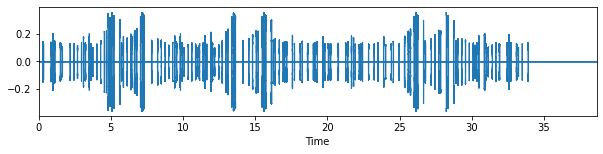

In [16]:
# The "filtering" thresholds will make the counter-melody sound more bassy, choppy and rythmic.

synthesized_counter = synth_counter(onset_env_flat, cent_harm, harmony=200, amplitude=0.00008, min_thresh=80, max_thresh=600)

# Visualizing the synth_test:
plt.figure(figsize=(10, 2))
librosa.display.waveplot(synthesized_counter)
ipd.Audio(synthesized_counter,rate=sr)

### 5.4 Merging the melody with the counter-melody

In [17]:
# Merging the two melodies
synthesized_sum = synthesized_counter + synthesized_harm
ipd.Audio(synthesized_sum,rate=sr)

### 6. The length of the synthesized compared to the original
It seems that the dur_ms of the sine_synth function only takes two decimals, and will ignore the rest. I've tried three different approaches to compute the perfect length to the synthesized sine-chunks, with the same number as the closest result. I've also tried changing the frame_length and hop_size, to hopefully arrive at the exact length as the original wavefile. This is the closest I could get, to my big dismay.

---

**Update**: With the new enveloped and overlapped sine-chunks, the difference is still the same 6.2 ms as in the first version of this assignment.

In [18]:
synth_length = librosa.get_duration(synthesized_sum)

# Displaying the length of the waveforms
print("Length of synthesized:\t {:.3f} s".format(synth_length))
print("Length of original:\t {:.3f} s".format(wave_length))

# Difference
print("Difference:\t\t ~= {:.1f} ms".format((synth_length-wave_length)*1000))

Length of synthesized:	 38.638 s
Length of original:	 38.632 s
Difference:		 ~= 6.2 ms


### 7. Bonus!
The synthesized waveforms merged with the percussive component of the original.

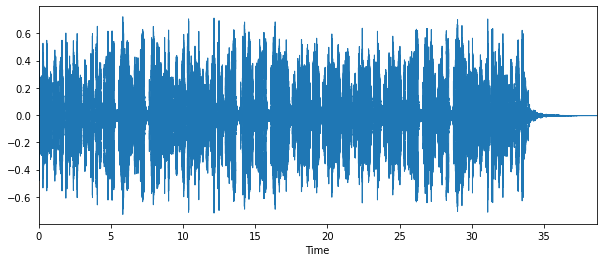

In [19]:
# Find which wave is the shortest
max_length = min(synthesized_sum.shape[0], wav_percussive.shape[0])

# Merging the two waves up to the last sample of the shortest one
bonus = synthesized_sum[:max_length] + wav_percussive[:max_length]

# Bonus merge:
plt.figure(figsize=(10, 4))
librosa.display.waveplot(bonus)
ipd.Audio(bonus,rate=sr)

### 8. The evolution of the process

Here's a recap with audio of the original, the synthesized melodies and the combination.
Run all cells to save them as .wav-files. (16bit / 22.05kHz / Mono)

**The original:**

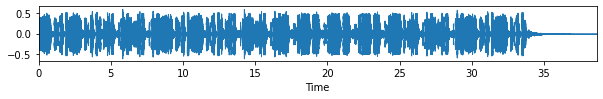

In [20]:
sf.write('./Files/1_Original.wav', wav, sr, subtype='PCM_16')

plt.figure(figsize=(10, 1))
librosa.display.waveplot(wav)
ipd.Audio(wav, rate=sr)

**The synthesized melodies:**

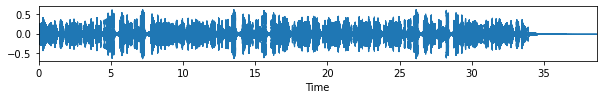

In [21]:
sf.write('./Files/2_Synthesized.wav', synthesized_sum, sr, subtype='PCM_16')

plt.figure(figsize=(10, 1))
librosa.display.waveplot(synthesized_sum)
ipd.Audio(synthesized_sum,rate=sr)

**The original and synthesized combined:**

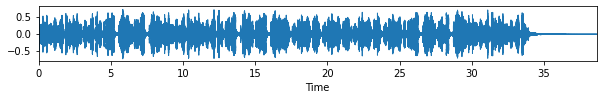

In [22]:
sf.write('./Files/3_Combined.wav', bonus, sr, subtype='PCM_16')

plt.figure(figsize=(10, 1))
librosa.display.waveplot(bonus)
ipd.Audio(bonus,rate=sr)

---

# What I've Learned

I've learned a lot by doing this assignment. It was way above my skill level when I started, and I spent the first couple of evenings stuck with some silly mistakes. (I added the sine-chunks on top of each-other, making a very complex (noise) and very short waveform, instead of appending them after each other). When I figured out how to the re-synthesizing work, I spent a lot of time trying to get the length exactly the same as the original. It seems like this is the closest I could get with this approach.

It was fun to try different parameters for the aesthetic choices, and a bit frustrating with how tedious it could be just to change one parameter. I spent a lot of time tweaking, and got new ideas which I implemented along the journey. (The harmonizing and the counter-melody)

This assignment was way more complex than I expected for a first assignment. I've spent nearly every evening until 2 AM for almost a week to wrap this up. But I think it was *very* rewarding to slowly grasp the different concepts. I guess I ended up making it more complicated for myself than strictly needed to finish the assignment, and that is just because it was so fun to explore and constantly try to take it a step further.

1) The handling of (numpy) arrays are still a bit mysterious to me, although I think I've got the basic idea. The most challenging part for me was to work with the different arrays made from extracting scalar features and re-synthesizing. I solved it by trial-and-error and reading.

2) I learned more about making useful functions, and learned basics of the Librosa library and how to import/export .wav-files to work with. (Generally, I gained a lot more knowledge about how libraries work in Python and how useful they are for different purposes.)

---

3) It's been fun to implement new concepts and techniques, learned after originally doing this assignment. I made a big effort to throw myself in the world of Python when initially tackling this assignment, and I hope it still holds up. It was a bit surprising how the numbers added up in the same way as the original, when applying overlaps. I was also surprised how easily it worked to do overlaps without zero-padding, just by treating similar shaped slices of different arrays.